# Preparation

In [2]:
import logging
import os
import sys

In [4]:
%cd /home/maminjeong/OFA/fairseq
%pip install tensorboard
%pip install ./
%cd ..

/home/maminjeong/OFA/fairseq
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.0/6.0 MB 44.8 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.3/5.3 MB 36.2 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 24.8 MB/s eta 0:00:0000:01
  Using cached google_auth-2.23.0-py2.py3-none-any.whl (181 kB)
  Using cached Markdown-3.4.4-py3-none-any.whl (94 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.9/4.9 MB 57.4 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 781.3/781.3 kB 24.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.6/233.6 kB 22.2 MB/s eta 0:00:00
  Using cached pyasn1_modules-0.3.0-py2.py3-none-any.whl (181 kB)
  Using cached cachetools-5.3.1-py3-none-any.whl (9.3 kB)
  Using cached urllib3-1.26.16-py2.py3-none-any.whl (143 kB)
  Using cached rsa-4.9-py3-none-any.whl (34 kB)
  Using cached requests_oauthlib-1.3.1-py2.py3-none-any.whl (23 kB)
  Using cached pyasn1-0.5.0-py2.py3-non

In [3]:
# 환경변수 설정

os.environ['PROTOCOL_BUFFERS_PYTHON_IMPLEMENTATION'] = "python"  # Google의 Protocol Buffers 라이브러리의 Python 구현을 선택하는데 사용됨 / Protocol Buffers는 Google에서 개발한 이식성이 좋고 효율적인 이진 데이터 포맷
!export PROTOCOL_BUFFERS_PYTHON_IMPLEMENTATION=python  # 리눅스 기반의 셀 환경에서 사용되며, 실행되는 다른 프로그램에서 이 환경변수를 참조할 수 있도록 함

In [4]:
import numpy as np
import torch

# OFA는 fairseq 라이브러리를 Codebase로 만들어짐
# fairseq는 Facebook AI Research 팀에 의해 개발된 오픈 소스 시퀀스-투-시퀀스 학습 툴킷, 기계 번역, 텍스트 생성 등 다양한 자연어 처리(NLP)와 시퀀스 예측 작업에 사용됨
# 설치 시 환경변수 설정과 '-e ./fairseq/' 옵션을 사용해서 editable 모드로 설치해야 됨, 로컬 디렉토리 ./fairseq/의 소스코드를 변경하고 그 변경사항을 테스트할 수 있음, 주로 setup.py 파일이 있는 디렉토리에서 사용됨
from fairseq import distributed_utils, options, tasks, utils, checkpoint_utils
from fairseq.dataclass.utils import convert_namespace_to_omegaconf
from fairseq.logging import progress_bar
from fairseq.utils import reset_logging
from omegaconf import DictConfig

/home/maminjeong/anaconda3/envs/OFA/lib/python3.7/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [11]:
from utils.zero_shot_utils import zero_shot_step
from tasks.mm_tasks.vqa_gen import VqaGenTask
from models.ofa import OFAModel
from PIL import Image

# Register VQA task
tasks.register_task('vqa_gen',VqaGenTask)

# turn on cuda if GPU is available
use_cuda = torch.cuda.is_available()
# use fp16 only when GPU is available
use_fp16 = False

# Build Model

In [5]:
# 사전 학습된 OFA_Tiny 모델 파일 다운로드 (Model: 563.26M, Params: 33M)
!wget https://ofa-beijing.oss-cn-beijing.aliyuncs.com/checkpoints/ofa_tiny.pt

--2023-09-18 16:09:38--  https://ofa-beijing.oss-cn-beijing.aliyuncs.com/checkpoints/ofa_tiny.pt
Resolving ofa-beijing.oss-cn-beijing.aliyuncs.com (ofa-beijing.oss-cn-beijing.aliyuncs.com)... 59.110.190.134
Connecting to ofa-beijing.oss-cn-beijing.aliyuncs.com (ofa-beijing.oss-cn-beijing.aliyuncs.com)|59.110.190.134|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 590617603 (563M) [application/octet-stream]
Saving to: ‘ofa_tiny.pt’

ofa_tiny.pt         100%[===================>] 563.26M  32.3MB/s    in 18s     

2023-09-18 16:09:56 (31.2 MB/s) - ‘ofa_tiny.pt’ saved [590617603/590617603]



In [6]:
# 사전 학습된 OFA_Medium 모델 파일 다운로드 (Model: 1.33G, Params: 93M)
!wget https://ofa-beijing.oss-cn-beijing.aliyuncs.com/checkpoints/ofa_medium.pt

--2023-09-18 16:10:51--  https://ofa-beijing.oss-cn-beijing.aliyuncs.com/checkpoints/ofa_medium.pt
Resolving ofa-beijing.oss-cn-beijing.aliyuncs.com (ofa-beijing.oss-cn-beijing.aliyuncs.com)... 59.110.190.134
Connecting to ofa-beijing.oss-cn-beijing.aliyuncs.com (ofa-beijing.oss-cn-beijing.aliyuncs.com)|59.110.190.134|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1425540445 (1.3G) [application/octet-stream]
Saving to: ‘ofa_medium.pt’

ofa_medium.pt       100%[===================>]   1.33G  39.7MB/s    in 38s     

2023-09-18 16:11:30 (35.5 MB/s) - ‘ofa_medium.pt’ saved [1425540445/1425540445]



In [1]:
# 사전 학습된 OFA_Base 모델 파일 다운로드 (Model: 2.44G, Params: 180M)
!wget https://ofa-beijing.oss-cn-beijing.aliyuncs.com/checkpoints/ofa_base.pt

--2023-09-18 15:46:18--  https://ofa-beijing.oss-cn-beijing.aliyuncs.com/checkpoints/ofa_base.pt
Resolving ofa-beijing.oss-cn-beijing.aliyuncs.com (ofa-beijing.oss-cn-beijing.aliyuncs.com)... 59.110.190.134
Connecting to ofa-beijing.oss-cn-beijing.aliyuncs.com (ofa-beijing.oss-cn-beijing.aliyuncs.com)|59.110.190.134|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2619535743 (2.4G) [application/octet-stream]
Saving to: ‘ofa_base.pt.1’

ofa_base.pt.1       100%[===================>]   2.44G  36.5MB/s    in 63s     

2023-09-18 15:47:22 (39.4 MB/s) - ‘ofa_base.pt.1’ saved [2619535743/2619535743]



In [2]:
# 사전 학습된 OFA_Large 모델 파일 다운로드 (Model: 5.80G, Params: 470M)
!wget https://ofa-beijing.oss-cn-beijing.aliyuncs.com/checkpoints/ofa_large.pt

--2023-09-18 15:54:03--  https://ofa-beijing.oss-cn-beijing.aliyuncs.com/checkpoints/ofa_large.pt
Resolving ofa-beijing.oss-cn-beijing.aliyuncs.com (ofa-beijing.oss-cn-beijing.aliyuncs.com)... 59.110.190.134
Connecting to ofa-beijing.oss-cn-beijing.aliyuncs.com (ofa-beijing.oss-cn-beijing.aliyuncs.com)|59.110.190.134|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 6231039997 (5.8G) [application/octet-stream]
Saving to: ‘ofa_large.pt.1’

ofa_large.pt.1      100%[===================>]   5.80G  38.9MB/s    in 2m 49s  

2023-09-18 15:56:52 (35.1 MB/s) - ‘ofa_large.pt.1’ saved [6231039997/6231039997]



In [3]:
# 사전 학습된 OFA_Huge 모델 파일 다운로드 (Model: 11.02G, Params: 930M)
!wget https://ofa-beijing.oss-cn-beijing.aliyuncs.com/checkpoints/ofa_huge.pt

--2023-09-18 15:59:35--  https://ofa-beijing.oss-cn-beijing.aliyuncs.com/checkpoints/ofa_huge.pt
Resolving ofa-beijing.oss-cn-beijing.aliyuncs.com (ofa-beijing.oss-cn-beijing.aliyuncs.com)... 59.110.190.134
Connecting to ofa-beijing.oss-cn-beijing.aliyuncs.com (ofa-beijing.oss-cn-beijing.aliyuncs.com)|59.110.190.134|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 11830570381 (11G) [application/octet-stream]
Saving to: ‘ofa_huge.pt.1’

ofa_huge.pt.1       100%[===================>]  11.02G  29.8MB/s    in 5m 56s  

2023-09-18 16:05:31 (31.7 MB/s) - ‘ofa_huge.pt.1’ saved [11830570381/11830570381]



In [4]:
!mv ofa_*.pt ./checkpoints/

In [12]:
# specify some options for evaluation
parser = options.get_generation_parser()  # 생성 작업에 대한 옵션 파서를 가져옴
input_args = ["", "--task=vqa_gen", "--beam=100", "--unnormalized", "--path=checkpoints/ofa_huge.pt", "--bpe-dir=utils/BPE"]  # Beam Search는 일정한 수의 가장 가능성 있는 후보를 유지하면서 시퀀스를 생성
args = options.parse_args_and_arch(parser, input_args)
cfg = convert_namespace_to_omegaconf(args)  # YAML, JSON과 같은 구성 파일로부터 설정을 로드하거나 Python 객체를 사용하여 프로그램 설정을 구성할 수 있게 함

# Load pretrained ckpt & config
task = tasks.setup_task(cfg.task)
models, cfg = checkpoint_utils.load_model_ensemble(
    utils.split_paths(cfg.common_eval.path),
    task=task
)

# Move models to GPU
for model in models:
    model.eval()
    if use_fp16:  # 실수를 16비트로 표현해 계산 속도를 향상시키고 메모리 사용량을 줄일 수 있음
        model.half()
    if use_cuda and not cfg.distributed_training.pipeline_model_parallel:
        model.cuda()
    model.prepare_for_inference_(cfg)

# Initialize generator
generator = task.build_generator(models, cfg.generation)

2023-09-18 16:27:45 | INFO | tasks.ofa_task | source dictionary: 59457 types
2023-09-18 16:27:45 | INFO | tasks.ofa_task | target dictionary: 59457 types
/home/maminjeong/anaconda3/envs/OFA/lib/python3.7/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


# Preprocess

In [13]:
# Image transform
from torchvision import transforms
mean = [0.5, 0.5, 0.5]
std = [0.5, 0.5, 0.5]

patch_resize_transform = transforms.Compose([
    lambda image: image.convert("RGB"),
    transforms.Resize((cfg.task.patch_image_size, cfg.task.patch_image_size), interpolation=Image.BICUBIC),  # 2D 이미지의 각 픽셀 주변의 4x4 그리드를 사용하여 보간을 수행, 픽셀 값의 미분값(기울기)까지 고려하여 부드러운 그래디언트와 자연스러운 이미지 텍스처를 유지
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std),
])

# Text preprocess
bos_item = torch.LongTensor([task.src_dict.bos()])
eos_item = torch.LongTensor([task.src_dict.eos()])
pad_idx = task.src_dict.pad()

# Normalize the question
def pre_question(question, max_ques_words):
    question = question.lower().lstrip(",.!?*#:;~").replace('-', ' ').replace('/', ' ')  # 문자열에서 왼쪽의 ,.!?*#:;~ 제거
    question = re.sub(
        r"\s{2,}",  # 공백 문자(스페이스, 탭, 줄바꿈 등)가 2개 이상 나타날 경우 스페이스로 대체
        ' ',
        question,
    )
    question = question.rstrip('\n')
    question = question.strip(' ')
    
    # truncate question
    question_words = question.split(' ')
    if len(question_words) > max_ques_words:
        question = ' '.join(question_words[:max_ques_words])
    return question

# bos, eos 토큰 추가
def encode_text(text, length=None, append_bos=False, append_eos=False):
    s = task.tgt_dict.encode_line(
        line=task.bpe.encode(text),
        add_if_not_exist=False,
        append_eos=False
    ).long()
    if length is not None:
        s = s[:length]
    if append_bos:
        s = torch.cat([bos_item, s])
    if append_eos:
        s = torch.cat([s, eos_item])
    return s

# Construct input for open-domain VQA task
def construct_sample(image: Image, question: str):
    patch_image = patch_resize_transform(image).unsqueeze(0)
    patch_mask = torch.tensor([True])

    question = pre_question(question, task.cfg.max_src_length)
    question = question + '?' if not question.endswith('?') else question
    src_text = encode_text(' {}'.format(question), append_bos=True, append_eos=True).unsqueeze(0)

    src_length = torch.LongTensor([s.ne(pad_idx).long().sum() for s in src_text])
    ref_dict = np.array([{'yes': 1.0}]) # just placeholder
    sample = {
        "id":np.array(['42']),
        "net_input": {
            "src_tokens": src_text,
            "src_lengths": src_length,
            "patch_images": patch_image,
            "patch_masks": patch_mask,
        },
        "ref_dict": ref_dict,
    }
    return sample

# Function to turn FP32 to FP16
# PyTorch 텐서 t의 데이터 타입이 torch.float32 (즉, 32-bit 부동 소수점)인 경우에 해당 텐서를 torch.half (16-bit half-precision 부동 소수점)로 변환
def apply_half(t):
    if t.dtype is torch.float32:
        return t.to(dtype=torch.half)
    return t

/home/maminjeong/anaconda3/envs/OFA/lib/python3.7/site-packages/torchvision/transforms/transforms.py:330: UserWarning: Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. Please use InterpolationMode enum.
  "Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. "


# Inference Test

In [14]:
import re

image = Image.open('./input_images/test.png')
question = "what is grown on the plant?"

sample = construct_sample(image, question)
sample = utils.move_to_cuda(sample) if use_cuda else sample
sample = utils.apply_to_sample(apply_half, sample) if use_fp16 else sample

In [15]:
# Run eval step for open-domain VQA
with torch.no_grad():
    result, scores = zero_shot_step(task, generator, models, sample)

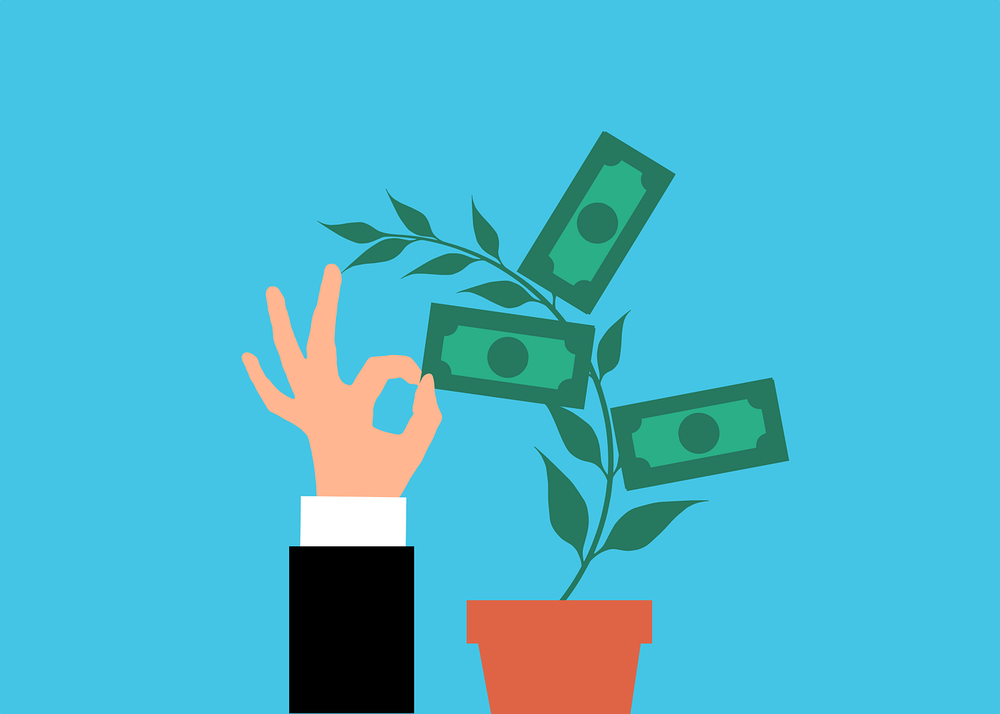

Question: what is grown on the plant?
OFA's Answer: money


In [16]:
display(image)
print('Question: {}'.format(question))
print('OFA\'s Answer: {}'.format(result[0]['answer']))

# Inference Pipeline

In [30]:
import re
from PIL import Image

def inference(model_path, image_path):
    # specify some options for evaluation
    parser = options.get_generation_parser()
    input_args = ["", "--task=vqa_gen", "--beam=100", "--unnormalized", f"--path=checkpoints/{model_path}.pt", "--bpe-dir=utils/BPE"]
    args = options.parse_args_and_arch(parser, input_args)
    cfg = convert_namespace_to_omegaconf(args)

    # Load pretrained ckpt & config
    task = tasks.setup_task(cfg.task)
    models, cfg = checkpoint_utils.load_model_ensemble(
        utils.split_paths(cfg.common_eval.path),
        task=task
    )

    # Move models to GPU
    for model in models:
        model.eval()
        if use_fp16:
            model.half()
        if use_cuda and not cfg.distributed_training.pipeline_model_parallel:
            model.cuda()
        model.prepare_for_inference_(cfg)

    # Initialize generator
    generator = task.build_generator(models, cfg.generation)

    image = Image.open(f'./input_images/{image_path}')
    questions = [
                "Where is the person?",
                "How many people are in the picture?",
                "How is the weather like in the picture?",
                "What accessories does the person wearing?",
                "What kind of hairstyle does the person have?",
                "What kind of shirt does a person wearing?",
                "How old does the person look like exactly?",
                "What country do you look like?"
                ]

    display(image)

    for idx, question in enumerate(questions):
        sample = construct_sample(image, question)
        sample = utils.move_to_cuda(sample) if use_cuda else sample
        sample = utils.apply_to_sample(apply_half, sample) if use_fp16 else sample

        # Run eval step for open-domain VQA
        with torch.no_grad():
            result, scores = zero_shot_step(task, generator, models, sample)

        print(f"Q{idx + 1}: {question}")
        print(f"A{idx + 1}: {result[0]['answer']}")
        print()

2023-09-18 16:41:11 | INFO | tasks.ofa_task | source dictionary: 59457 types
2023-09-18 16:41:11 | INFO | tasks.ofa_task | target dictionary: 59457 types


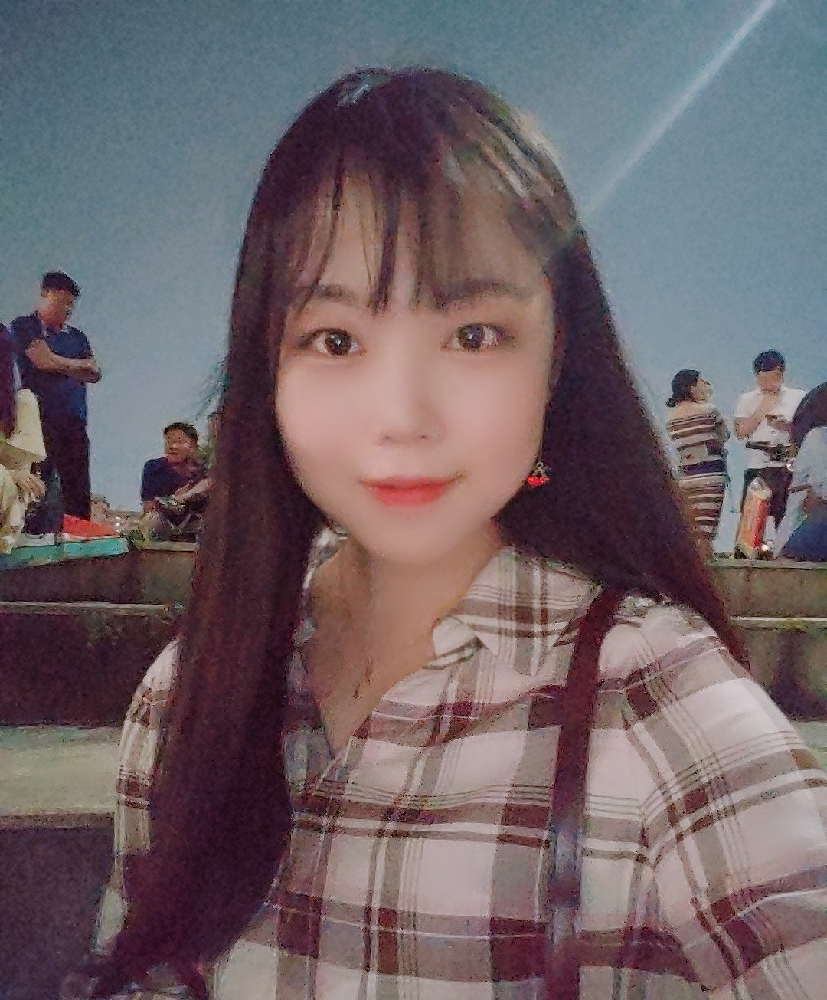

Q1: Where is the person?
A1: in a dress

Q2: How many people are in the picture?
A2: 3

Q3: How is the weather like in the picture?
A3: sunny

Q4: What accessories does the person wearing?
A4: apron

Q5: What kind of hairstyle does the person have?
A5: hair

Q6: What kind of shirt does a person wearing?
A6: apron

Q7: How old does the person look like exactly?
A7: old

Q8: What country do you look like?
A8: america



In [31]:
inference('ofa_tiny', 'minjeong.jpeg')

2023-09-18 16:42:10 | INFO | tasks.ofa_task | source dictionary: 59457 types
2023-09-18 16:42:10 | INFO | tasks.ofa_task | target dictionary: 59457 types


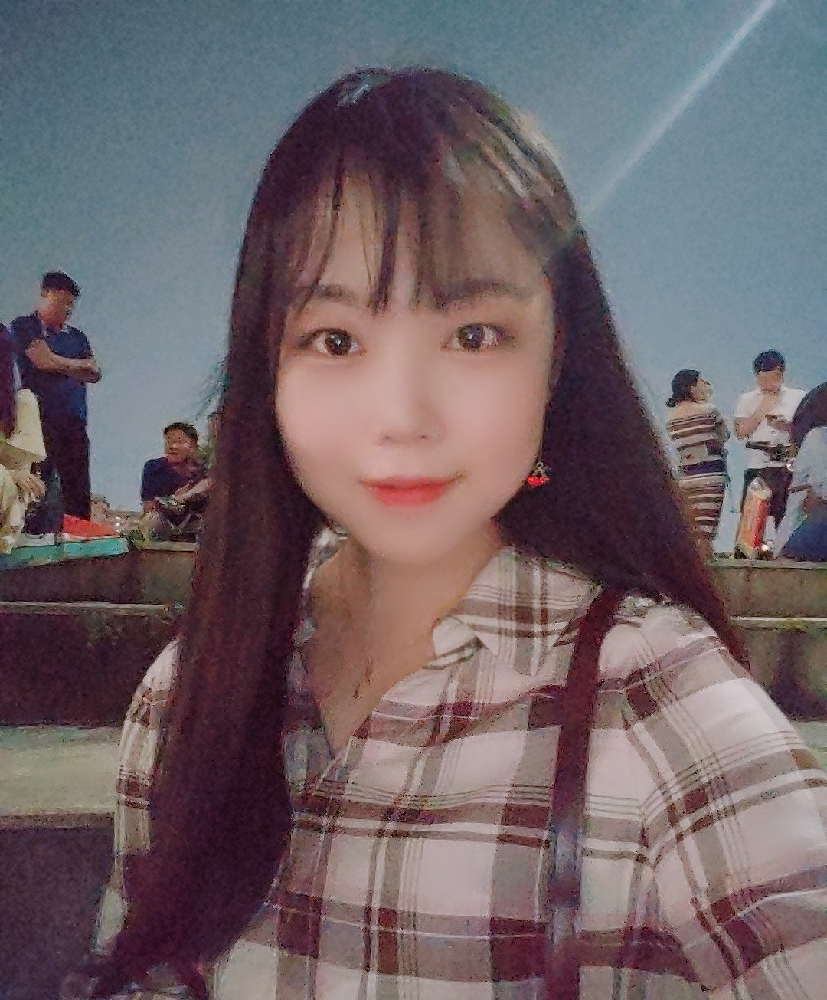

Q1: Where is the person?
A1: sitting on the stairs

Q2: How many people are in the picture?
A2: no

Q3: How is the weather like in the picture?
A3: overcast

Q4: What accessories does the person wearing?
A4: the girl is wearing a plaid shirt

Q5: What kind of hairstyle does the person have?
A5: long straight straight hairstyle

Q6: What kind of shirt does a person wearing?
A6: girl in a plaid shirt

Q7: How old does the person look like exactly?
A7: the girl is still in school

Q8: What country do you look like?
A8: no



In [32]:
inference('ofa_medium', 'minjeong.jpeg')

2023-09-18 16:42:45 | INFO | tasks.ofa_task | source dictionary: 59457 types
2023-09-18 16:42:45 | INFO | tasks.ofa_task | target dictionary: 59457 types


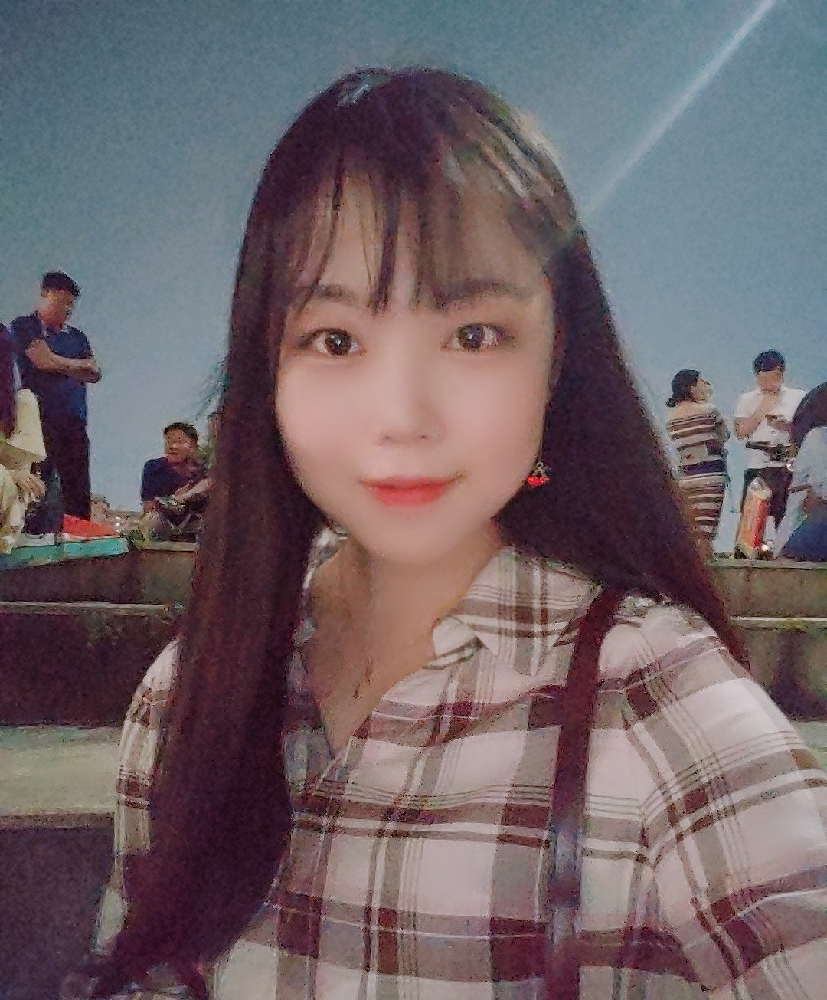

Q1: Where is the person?
A1: on the bench

Q2: How many people are in the picture?
A2: 5

Q3: How is the weather like in the picture?
A3: sunny

Q4: What accessories does the person wearing?
A4: sneakers

Q5: What kind of hairstyle does the person have?
A5: straight

Q6: What kind of shirt does a person wearing?
A6: plaid

Q7: How old does the person look like exactly?
A7: young

Q8: What country do you look like?
A8: mexico



In [33]:
inference('ofa_base', 'minjeong.jpeg')

2023-09-18 16:43:13 | INFO | tasks.ofa_task | source dictionary: 59457 types
2023-09-18 16:43:13 | INFO | tasks.ofa_task | target dictionary: 59457 types


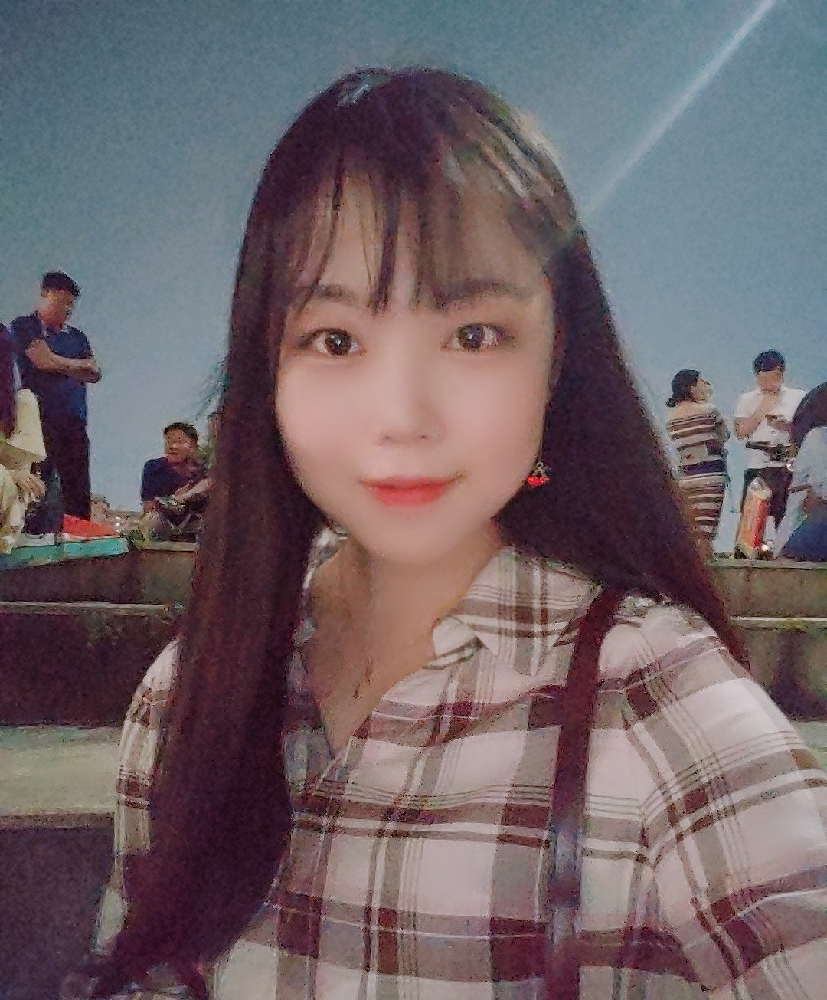

Q1: Where is the person?
A1: stadium

Q2: How many people are in the picture?
A2: six

Q3: How is the weather like in the picture?
A3: sunny

Q4: What accessories does the person wearing?
A4: earrings and a necklace

Q5: What kind of hairstyle does the person have?
A5: dreadlocks

Q6: What kind of shirt does a person wearing?
A6: plaid

Q7: How old does the person look like exactly?
A7: 16

Q8: What country do you look like?
A8: india



In [34]:
inference('ofa_large', 'minjeong.jpeg')

2023-09-18 16:43:42 | INFO | tasks.ofa_task | source dictionary: 59457 types
2023-09-18 16:43:42 | INFO | tasks.ofa_task | target dictionary: 59457 types


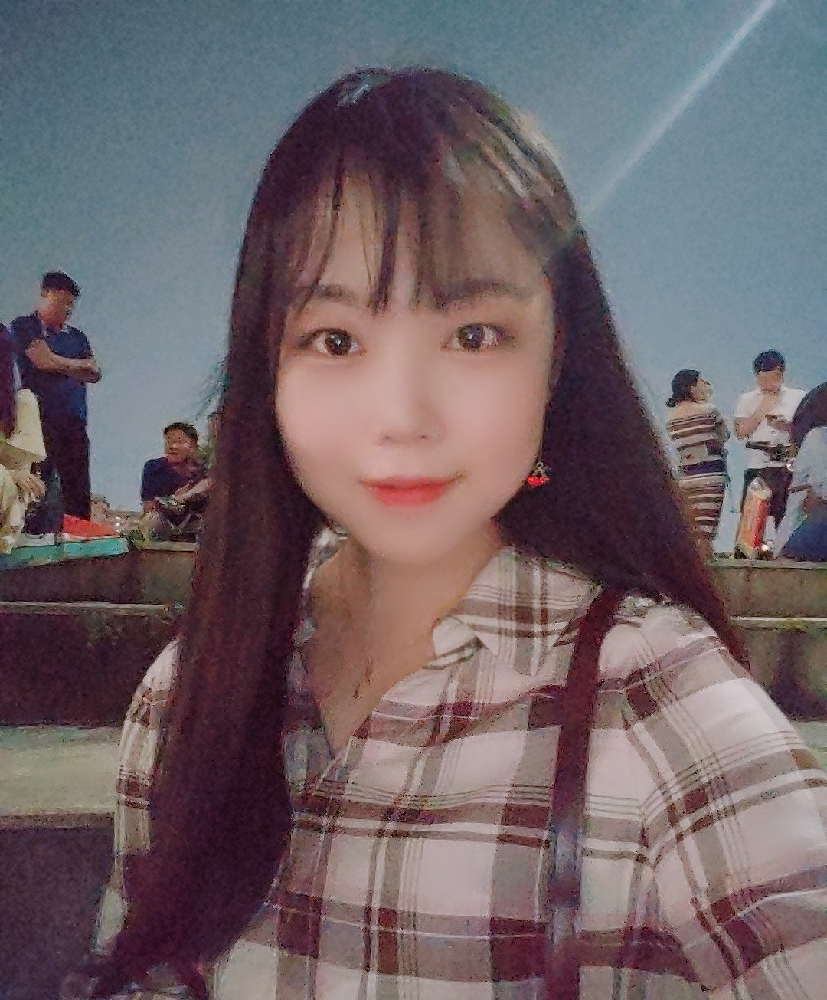

Q1: Where is the person?
A1: outside somewhere

Q2: How many people are in the picture?
A2: 7

Q3: How is the weather like in the picture?
A3: overcast

Q4: What accessories does the person wearing?
A4: earrings

Q5: What kind of hairstyle does the person have?
A5: long straight hair

Q6: What kind of shirt does a person wearing?
A6: plaid

Q7: How old does the person look like exactly?
A7: 12

Q8: What country do you look like?
A8: china



: 

In [35]:
inference('ofa_huge', 'minjeong.jpeg')

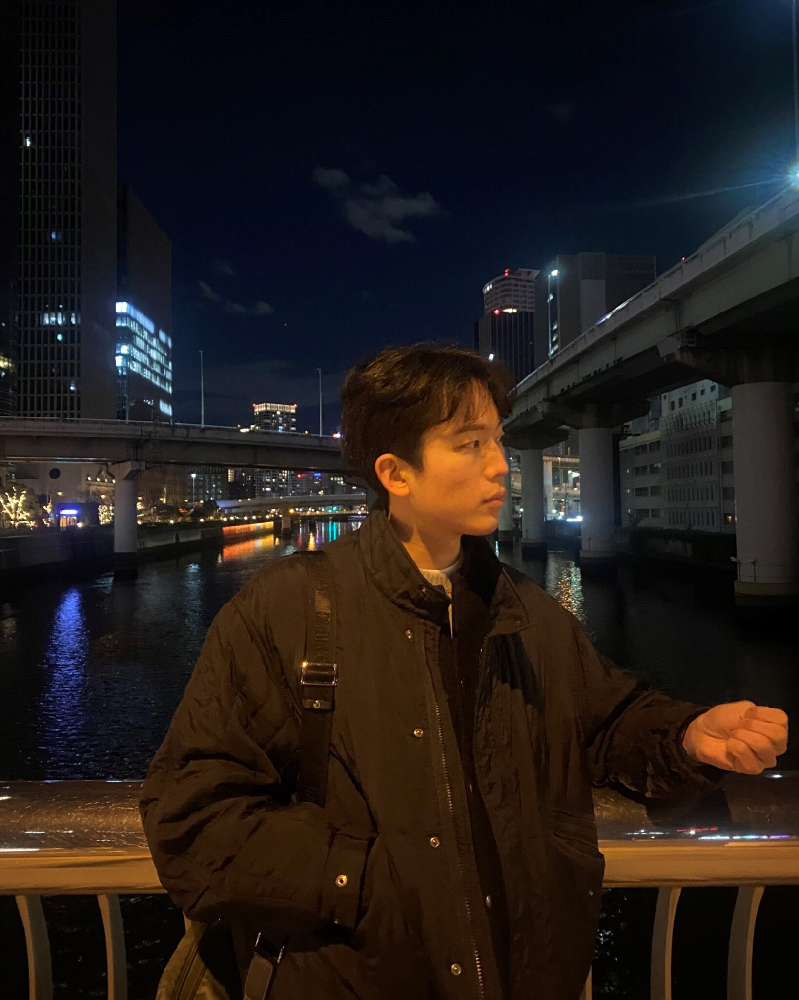

Q1: Where is the person?
A1: city

Q2: How many people are in the picture?
A2: one

Q3: How is the weather like in the picture?
A3: partly cloudy

Q4: What accessories does the person wearing?
A4: backpack

Q5: What kind of hairstyle does the person have?
A5: short

Q6: What kind of shirt does a person wearing?
A6: button down

Q7: How old does the person look like exactly?
A7: middle aged

Q8: What country do you look like?
A8: japan



In [26]:
inference('kiyoon.jpeg')

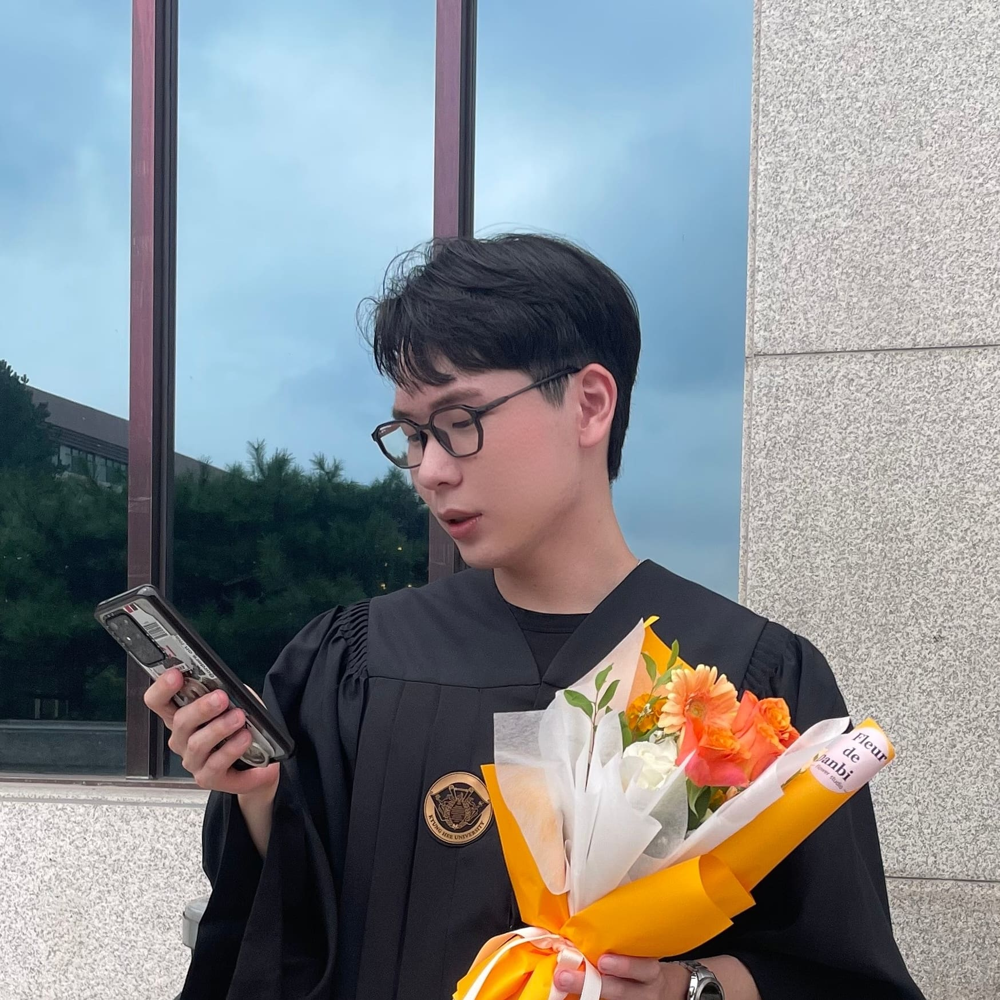

Q1: Where is the person?
A1: outside a building

Q2: How many people are in the picture?
A2: one

Q3: How is the weather like in the picture?
A3: cloudy

Q4: What accessories does the person wearing?
A4: glasses

Q5: What kind of hairstyle does the person have?
A5: short

Q6: What kind of shirt does a person wearing?
A6: t-shirt

Q7: How old does the person look like exactly?
A7: 20

Q8: What country do you look like?
A8: usa



In [27]:
inference('seonghee.jpeg')

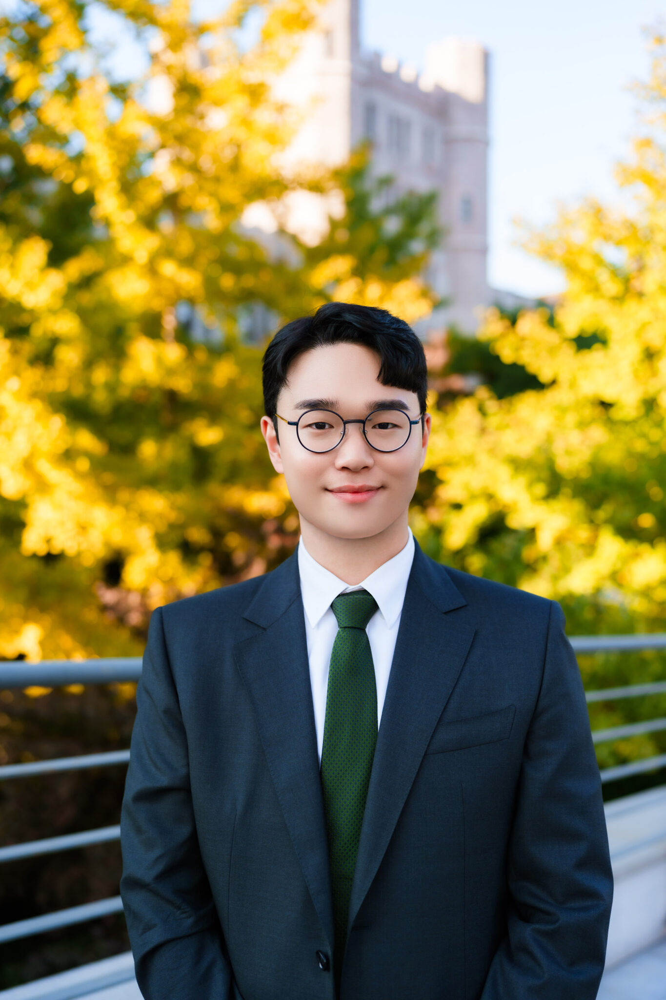

Q1: Where is the person?
A1: in front of the trees

Q2: How many people are in the picture?
A2: one

Q3: How is the weather like in the picture?
A3: overcast

Q4: What accessories does the person wearing?
A4: glasses

Q5: What kind of hairstyle does the person have?
A5: short

Q6: What kind of shirt does a person wearing?
A6: a dress shirt

Q7: How old does the person look like exactly?
A7: young

Q8: What country do you look like?
A8: usa



In [28]:
inference('woojun.jpeg')